<center>

# Diplomatura en Ciencia de Datos, Aprendizaje Automático y sus Aplicaciones
    
## Práctico # 1. Análisis y visualización de datos
## <span style="color:red">**Fecha de entrega:** 1 de julio de 2024</span>

</center>

--------------

## Análisis y Predicción de Calidad del Aire en una Zona Urbana: Exploración de Datos Multisensor y Modelado Predictivo

<span style="font-family: Arial, sans-serif; font-size: 16px;">
    
La calidad del aire es un tema importante en la agenda mundial de salud ambiental. Según la OMS (2018), los contaminantes atmosféricos son responsables de 1 de cada 9 muertes. Sin embargo, muchas partes del mundo carecen de datos básicos sobre la calidad del aire.
    
Este conjunto de datos contiene respuestas de un dispositivo multisensor de gases instalado en una zona significativamente contaminada en Italia. El objetivo es examinar cómo los factores ambientales y la concentración de contaminantes interactúan entre sí. Lo que permitirá comprender el nivel de contaminación del área urbana y utilizar la ciencia de datos para informar estrategias de salud ambiental y recomendaciones prácticas para mejorar la calidad del aire y proteger la salud de las personas que viven allí.  

Los datos fueron tomados de https://archive.ics.uci.edu/dataset/360/air+quality
    
</span>

<span style="font-family: Arial, sans-serif; font-size: 16px;">
    
### Dataset:
    
Consta de 9471 filas y 17 columnas, registrando promedios horarios de respuestas y concentraciones de gases, obtenidas por un analizador certificado mediante sensores químicos de óxido de metal (identificados como PT08.S1, S2, S3, S4 y S5), abarcando un periodo de 1 año a partir del mes de marzo de 2004 y abril de 2005. Los datos faltantes se han codificado como -200.

**Variables a analizar**
    
1. **Fecha** (DD/MM/AAAA)
    
2. **Hora** (HH.MM.SS)
    
3. **CO (GT)**: concentración promedio horaria real de CO en mg/m3 (analizador de referencia)
    
4. **PT08.S1 (óxido de estaño)**: respuesta promedio horaria del sensor (nominalmente objetivo de CO)
    
5. **NMHC (GT)**: concentración total promedio horaria real de hidrocarburos no metánicos en microg/m3 (analizador de referencia)
    
6. **C6H6(GT)**: concentración de benceno promediada por hora real en microg/m3 (analizador de referencia)
    
7. **PT08.S2 (titania)**: respuesta promedio horaria del sensor (nominalmente dirigida a NMHC)
    
8. **NOx(GT)**: concentración de NOx promediada por hora real en ppb (analizador de referencia)
    
9. **PT08.S3 (óxido de tungsteno)**: respuesta promedio horaria del sensor (nominalmente objetivo de NOx)
    
10. **NO2(GT)**: concentración de NO2 promediada por hora real en microg/m3 (analizador de referencia)
    
11. **PT08.S4 (óxido de tungsteno)**: respuesta promedio horaria del sensor (nominalmente objetivo de NO2)
    
12. **PT08.S5 (óxido de indio)**: respuesta promedio horaria del sensor (nominalmente objetivo de O3)
    
13. **T**: Temperatura en °C
    
14. **HR**: Humedad relativa (%)
    
15. **AH**: Humedad Absoluta
    
</span>

<span style="font-family: Arial, sans-serif; font-size: 16px;">
    
### Preguntas a responder en el práctico 1:

1.	¿Cuáles son los valores mínimos y máximos de cada contaminante reportados en el estudio?

2.	¿Cómo varían las concentraciones de los contaminantes durante el día?

3.	¿Cómo se distribuyen los valores de los contaminantes aplicando gráficos de distribución? ¿existen valores anómalos en los datos que puedan afectar nuestros análisis?

</span>

<span style="font-family: Arial, sans-serif; font-size: 16px;">
    
#### Para inspeccionar y descargar el conjunto de datos, acceder al siguiente repositorio:

https://github.com/PatriMiranda/Calidad-de-Aire/blob/main/AirQualityUCI.csv

</span>

-----

# Importamos librerías

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import scipy.stats as stats
import missingno as msno


In [ ]:
# Cargar el dataset

df = pd.read_csv("https://raw.githubusercontent.com/PatriMiranda/Calidad-de-Aire/main/AirQualityUCI.csv", delimiter=',')
df.head(5)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
0,10/03/2004,18:00:00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,NaN,NaN
1,10/03/2004,19:00:00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,NaN,NaN
2,10/03/2004,20:00:00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,NaN,NaN
3,10/03/2004,21:00:00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,NaN,NaN
4,10/03/2004,22:00:00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,NaN,NaN


Llama la atención que las ultimas columnas tiene todos variables Nan

In [ ]:
# Observar la info que contienen las primeras filas

df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
0,10/03/2004,18:00:00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,NaN,NaN
1,10/03/2004,19:00:00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,NaN,NaN
2,10/03/2004,20:00:00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,NaN,NaN
3,10/03/2004,21:00:00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,NaN,NaN
4,10/03/2004,22:00:00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,NaN,NaN


In [ ]:
# Observar la info que contienen las ultimas filas

df.tail(114)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
9357,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9358,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9359,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9360,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9361,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9468,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Se observan registros en los cuales todas sus variables son Nan. Por lo cual procedemos a ver la cantidad que hay.

In [ ]:
# Conocer la estructura del dataset

print("Estructura de dataframe", df.shape)
df.info()

Estructura de dataframe (9471, 17)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         9357 non-null   float64
 3   PT08.S1(CO)    9357 non-null   float64
 4   NMHC(GT)       9357 non-null   float64
 5   C6H6(GT)       9357 non-null   float64
 6   PT08.S2(NMHC)  9357 non-null   float64
 7   NOx(GT)        9357 non-null   float64
 8   PT08.S3(NOx)   9357 non-null   float64
 9   NO2(GT)        9357 non-null   float64
 10  PT08.S4(NO2)   9357 non-null   float64
 11  PT08.S5(O3)    9357 non-null   float64
 12  T              9357 non-null   float64
 13  RH             9357 non-null   float64
 14  AH             9357 non-null   float64
 15  Unnamed: 15    0 non-null      float64
 16  Unnamed: 16    0 non-null      float64
dtypes: float64(15), o

<Axes: >

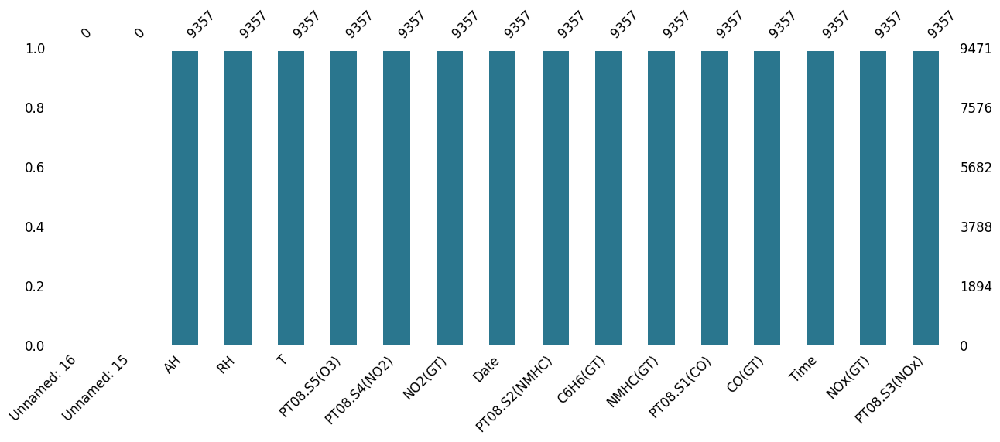

In [ ]:
# Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', 256)

# Seleccionar un color específico de la paleta 'viridis'
viridis_color = viridis_palette[100]  # Puedes cambiar el índice para seleccionar un color diferente

# Graficar la matriz de valores faltantes
msno.bar(df, figsize=(15, 5), sort="ascending", fontsize=12, color=viridis_color)


In [ ]:
#Cantidad de valores nulos por columnas
df.isnull().sum()

,0
Date,114
Time,114
CO(GT),114
PT08.S1(CO),114
NMHC(GT),114
C6H6(GT),114
PT08.S2(NMHC),114
NOx(GT),114
PT08.S3(NOx),114
NO2(GT),114


In [ ]:
# El nombre de las columnas

df.columns

Index(['Date', 'Time', 'CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)',
       'PT08.S2(NMHC)', 'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)',
       'PT08.S5(O3)', 'T', 'RH', 'AH', 'Unnamed: 15', 'Unnamed: 16'],
      dtype='object')

Se observan que en las variables 15 y 16 llamadas `'Unnamed:15'` y `'Unnamed:16'` todas sus varibales son NAN. En el caso del resto de variables vemos que todas poseen una cantidad de valores 9357 no nulos de 9471 de registros totales. Es decir que 114 filas tiene valores nulos, y curiosamente estan todos registrados ene los ultimos 114 registros del dataset.

Pueden existir varias razones por las cuales estos registros completamente nulos esten presentes:
- Un mal funcionamiento de los sensores
- Una corrupcion del archivo
- Una mala imputacion, al agregar los `'-200'` al dataset.

In [ ]:
df.describe()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
count,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,0.0,0.0
mean,-34.207524,1048.990061,-159.090093,1.865683,894.595276,168.616971,794.990168,58.148873,1391.479641,975.072032,9.778305,39.485380,-6.837604,NaN,NaN
std,77.657170,329.832710,139.789093,41.380206,342.333252,257.433866,321.993552,126.940455,467.210125,456.938184,43.203623,51.216145,38.976670,NaN,NaN
min,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,NaN,NaN
25%,0.600000,921.000000,-200.000000,4.000000,711.000000,50.000000,637.000000,53.000000,1185.000000,700.000000,10.900000,34.100000,0.692300,NaN,NaN
50%,1.500000,1053.000000,-200.000000,7.900000,895.000000,141.000000,794.000000,96.000000,1446.000000,942.000000,17.200000,48.600000,0.976800,NaN,NaN
75%,2.600000,1221.000000,-200.000000,13.600000,1105.000000,284.000000,960.000000,133.000000,1662.000000,1255.000000,24.100000,61.900000,1.296200,NaN,NaN
max,11.900000,2040.000000,1189.000000,63.700000,2214.000000,1479.000000,2683.000000,340.000000,2775.000000,2523.000000,44.600000,88.700000,2.231000,NaN,NaN


Luego de ver algunas estadisticas descriptivas de nuestro dataset notamos que hay muchos valores con -200. Es el caso del valor minimo que aprarece un -200 en todas nuestras variables

In [ ]:
cantidad_faltantes_por_columna = (df == -200).sum()
print(cantidad_faltantes_por_columna)

Date                0
Time                0
CO(GT)           1683
PT08.S1(CO)       366
NMHC(GT)         8443
C6H6(GT)          366
PT08.S2(NMHC)     366
NOx(GT)          1639
PT08.S3(NOx)      366
NO2(GT)          1642
PT08.S4(NO2)      366
PT08.S5(O3)       366
T                 366
RH                366
AH                366
Unnamed: 15         0
Unnamed: 16         0
dtype: int64


---

# 1- ¿Cuáles son los valores mínimos y máximos de cada contaminante reportados en el estudio?

In [ ]:
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
0,10/03/2004,18:00:00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,NaN,NaN
1,10/03/2004,19:00:00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,NaN,NaN
2,10/03/2004,20:00:00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,NaN,NaN
3,10/03/2004,21:00:00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,NaN,NaN
4,10/03/2004,22:00:00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,NaN,NaN


In [ ]:
min_val= []
max_val= []
for column in df.columns[2:]:#no usamos para calcular minimo y maximo las columnas data y time
    min_val.append(df[column].min())

    max_val.append(df[column].max())

Buscamos el valor maximo y minimo para cada variable

In [ ]:
columns=df.columns.drop(['Date','Time'])
max_min_df = pd.DataFrame({'Feature': df.columns[2:], 'min': min_val, 'max': max_val})
max_min_df

,Feature,min,max
0,CO(GT),-200.0,11.900
1,PT08.S1(CO),-200.0,2040.000
2,NMHC(GT),-200.0,1189.000
3,C6H6(GT),-200.0,63.700
4,PT08.S2(NMHC),-200.0,2214.000
5,NOx(GT),-200.0,1479.000
6,PT08.S3(NOx),-200.0,2683.000
7,NO2(GT),-200.0,340.000
8,PT08.S4(NO2),-200.0,2775.000
9,PT08.S5(O3),-200.0,2523.000


Ahora vemos el minimo verdadero sin tener en cuenta los valores -200

In [ ]:
# Filtramos el DataFrame para que solo incluya valores mayores que -200
var = [ 'CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)',
       'PT08.S2(NMHC)', 'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)',
       'PT08.S5(O3)', 'T', 'RH', 'AH', 'Unnamed: 15', 'Unnamed: 16']
df_filtrado = df[df[var] > -200]

# Generar el resumen estadístico
descripcion = df_filtrado.describe()

# Filtrar solo los valores mínimos y máximos y transponer el resultado
min_max_descripcion = descripcion.loc[['count','min', 'max']].transpose()

In [ ]:
min_max_descripcion

,count,min,max
CO(GT),7674.0,0.1000,11.900
PT08.S1(CO),8991.0,647.0000,2040.000
NMHC(GT),914.0,7.0000,1189.000
C6H6(GT),8991.0,0.1000,63.700
PT08.S2(NMHC),8991.0,383.0000,2214.000
NOx(GT),7718.0,2.0000,1479.000
PT08.S3(NOx),8991.0,322.0000,2683.000
NO2(GT),7715.0,2.0000,340.000
PT08.S4(NO2),8991.0,551.0000,2775.000
PT08.S5(O3),8991.0,221.0000,2523.000


In [ ]:
# Calcular los valores máximos y mínimos por columna
df_filtrado=df_filtrado.drop(columns=['Date','Time','Unnamed: 15', 'Unnamed: 16'])
valores_maximos = df_filtrado.max()
valores_minimos = df_filtrado.min()

In [ ]:
valores_maximos.sort_values(ascending=False)
valores_minimos.sort_values(ascending=False)

,0
PT08.S1(CO),647.0000
PT08.S4(NO2),551.0000
PT08.S2(NMHC),383.0000
PT08.S3(NOx),322.0000
PT08.S5(O3),221.0000
RH,9.2000
NMHC(GT),7.0000
NOx(GT),2.0000
NO2(GT),2.0000
AH,0.1847


In [ ]:
order_maximos = valores_maximos.sort_values(ascending=False)
order_minimos = valores_minimos.sort_values(ascending=False)

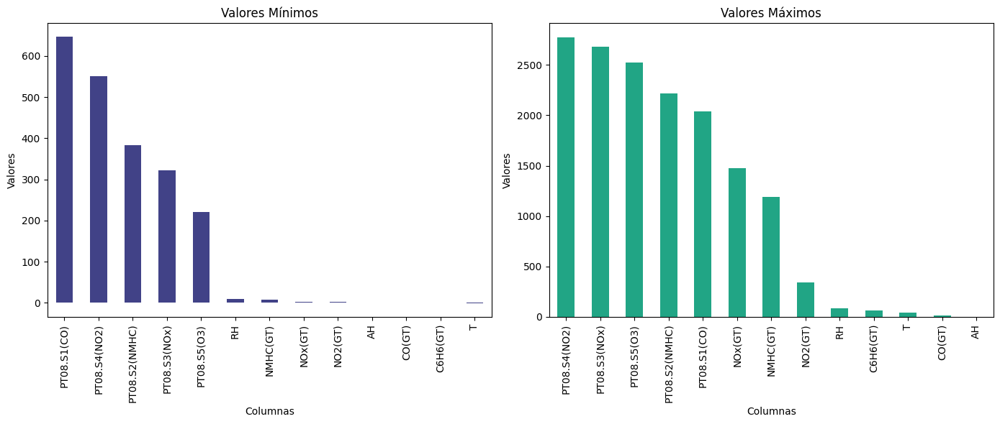

In [ ]:
# Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', 256)

# Seleccionar colores específicos de la paleta 'viridis'
color_minimos = viridis_palette[50]  # Color para los valores mínimos
color_maximos = viridis_palette[150]  # Color para los valores máximos
# Configurar el tamaño de los gráficos
plt.figure(figsize=(14, 6))

# Gráfico de barras para los valores mínimos
plt.subplot(1, 2, 1)
order_minimos.plot(kind='bar',color=color_minimos, )
plt.title('Valores Mínimos')
plt.xlabel('Columnas')
plt.ylabel('Valores')
# Gráfico de barras para los valores máximos
plt.subplot(1, 2, 2)
order_maximos.plot(kind='bar', color=color_maximos)
plt.title('Valores Máximos')
plt.xlabel('Columnas')
plt.ylabel('Valores')


# Mostrar los gráficos
plt.tight_layout()
plt.show()

Distribución de los Datos:

Las medidas de contaminantes (por ejemplo, `'CO(GT)'`, `'NOx(GT))'` y de condiciones ambientales (por ejemplo, `'T'`, `'RH'`) varían significativamente.
Los sensores (`'PT08.S1(CO)'` a `'PT08.S5(O3)'`) tienen respuestas con valores máximos altos, lo cual indica una alta sensibilidad o variabilidad en la concentración de los contaminantes que miden.

Rangos de Variación:

Algunos contaminantes como `'PT08.S3(NOx)'` y `'PT08.S4(NO2)'` tienen valores máximos muy altos en comparación con otros, lo que podría indicar picos de contaminación.

Las características `'Unnamed: 15'` y `'Unnamed: 16'` parecen ser irrelevantes ya que no tienen valores significativos.

# 2.	¿Cómo varían las concentraciones de los contaminantes durante el día?

In [ ]:
df.head(5)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
0,10/03/2004,18:00:00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,NaN,NaN
1,10/03/2004,19:00:00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,NaN,NaN
2,10/03/2004,20:00:00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,NaN,NaN
3,10/03/2004,21:00:00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,NaN,NaN
4,10/03/2004,22:00:00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,NaN,NaN


In [ ]:
df['Datatime'] = pd.to_datetime(df['Date'] + ' '+ df['Time'],format='%d/%m/%Y %H:%M:%S')	# Convertir la columna 'Date' a formato de fecha

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Date           9357 non-null   object        
 1   Time           9357 non-null   object        
 2   CO(GT)         9357 non-null   float64       
 3   PT08.S1(CO)    9357 non-null   float64       
 4   NMHC(GT)       9357 non-null   float64       
 5   C6H6(GT)       9357 non-null   float64       
 6   PT08.S2(NMHC)  9357 non-null   float64       
 7   NOx(GT)        9357 non-null   float64       
 8   PT08.S3(NOx)   9357 non-null   float64       
 9   NO2(GT)        9357 non-null   float64       
 10  PT08.S4(NO2)   9357 non-null   float64       
 11  PT08.S5(O3)    9357 non-null   float64       
 12  T              9357 non-null   float64       
 13  RH             9357 non-null   float64       
 14  AH             9357 non-null   float64       
 15  Unnamed: 15    0 non-

In [ ]:
df.columns[2:-3]

Index(['CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
       'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
       'T', 'RH', 'AH'],
      dtype='object')

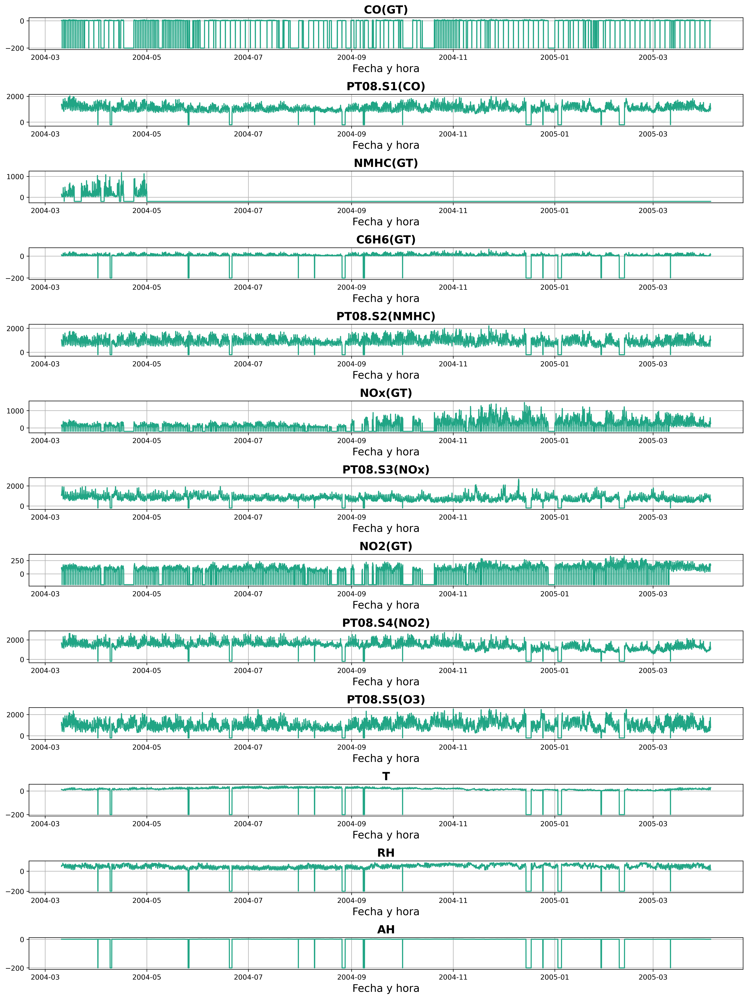

In [ ]:
# Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', 256)

# Seleccionar un color específico de la paleta 'viridis'
viridis_color = viridis_palette[150]

# Crear subplots para cada columna en un gráfico separado
num_columns = len(df.columns[2:-3])
fig, axs = plt.subplots(num_columns, 1, figsize=(15, 20), dpi=400)

for i, column in enumerate(df.columns[2:-3]):
    axs[i].plot(df['Datatime'], df[column], color=viridis_color)
    axs[i].set_title(column, fontsize=16, fontweight='bold')
    axs[i].set_xlabel('Fecha y hora', fontsize=15)
    axs[i].set_ylabel('')
    axs[i].grid(True)

plt.tight_layout()
plt.show()

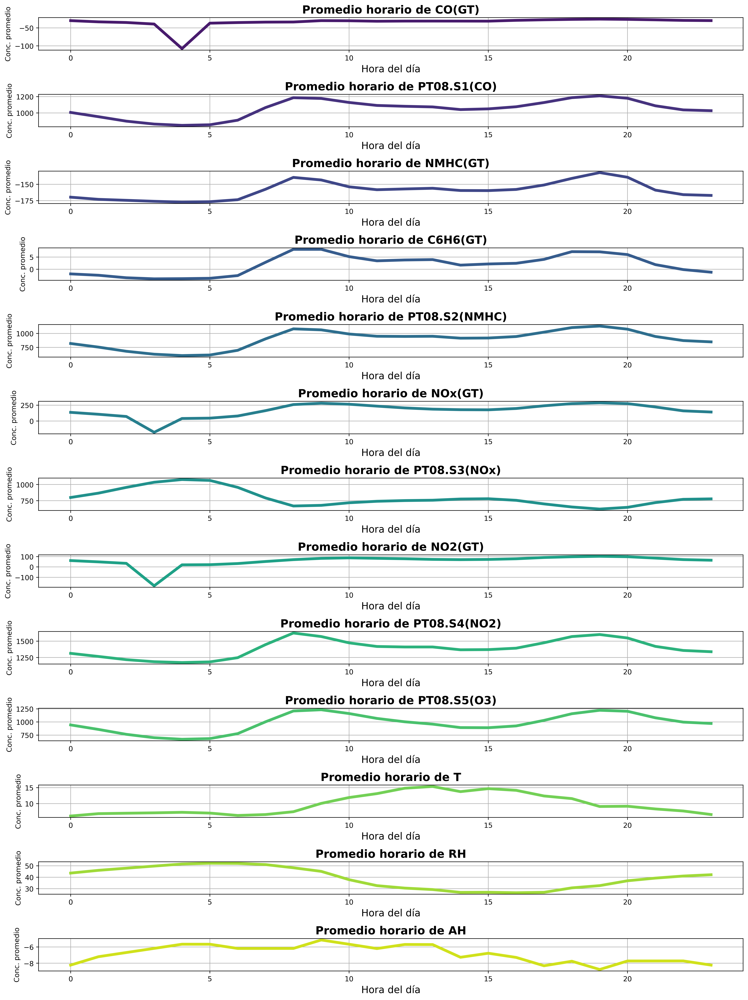

In [ ]:
# Extraer la hora de la columna 'Datatime'
df['Hour'] = df['Datatime'].dt.hour

# Crear una figura y ejes para cada columna
num_columns = len(df.columns[2:-4])
fig, axs = plt.subplots(num_columns, 1, figsize=(15, 20),dpi=400)

#colores a usar
palette = sns.color_palette("viridis", num_columns)

# Iterar sobre cada columna
for i, column in enumerate(df.columns[2:-4]):
    # Agrupar por hora y calcular el promedio
    hourly_means = df.groupby('Hour')[column].mean()

    # Graficar las medias horarias

    axs[i].plot(hourly_means.index, hourly_means.values,color=palette[i],linewidth=4)
    axs[i].set_title(f'Promedio horario de {column}',fontsize=16,fontweight='bold')
    axs[i].set_xlabel('Hora del día',fontsize=14)
    axs[i].set_ylabel('Conc. promedio')
    axs[i].grid(True)

plt.tight_layout()
plt.show()



In [ ]:
df.columns

Index(['Date', 'Time', 'CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)',
       'PT08.S2(NMHC)', 'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)',
       'PT08.S5(O3)', 'T', 'RH', 'AH', 'Unnamed: 15', 'Unnamed: 16',
       'Datatime', 'Hour'],
      dtype='object')

Luego de visualizar los gráficos de promedios para cada franja horaria podemos ver:
* `'CO(GT)'`, `'NO2(GT)'`,`'NOx(GT)'`:concentración promedio horaria real de CO, tiene cierta constancia a lo largo del día teniendo un gran declive alrededor de las 4 a.m. El mismo puede deberse a la gran cantidad de datos con valor `'-200'` a esa hora.
  * En el caso de las variables `'PT08.S2 (titania)'`, `'NMHC (GT)'` los cambios son mucho más suavizado que las otras.
* `'PT08.S1(CO)'`, `'NMHC(GT)'`, `'C6H6(GT)'`, `'PT08.S2(NMHC)'`, `'PT08.S4(NO2)'`, `'PT08.S5(O3)'`:  vemos que tenemos valores mayores para las franjas horarias correpondientes a los valores pico, es decir para los horarios entre 7-9 y 18-20hs. Esto mismo puede deberse a que en dichas franjas horarias hay mayor circulacion de vehiculos.

*  `'T'`: vemos que los valores de la misma van aumentando hasta llegar al maximo alrededor de 14hs para luego volver a descender.

* `'RH'`: pareciera que tuviera un comportamiento ciclico, con picos cada 20 hs, por lo que se ve en la hora 5 y una posible proyeccion a la 1hs de la mañana.

* `'AH'`:


# 3.	¿Cómo se distribuyen los valores de los contaminantes aplicando gráficos de distribución? ¿existen valores anómalos en los datos que puedan afectar nuestros análisis?

## Análisis con los valores -200 originales

In [ ]:
df.columns[2:-4]

Index(['CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
       'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
       'T', 'RH', 'AH'],
      dtype='object')

In [ ]:
# Lista de columnas de contaminantes
columns = ['CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
           'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
          'T', 'RH', 'AH']

# Número de columnas a mostrar en la cuadrícula
num_cols = 4  # Puedes cambiar este valor para ajustar la distribución horizontal
num_rows = (len(columns) + num_cols - 1) // num_cols  # Calcular filas necesarias

# Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', len(columns))

# Crear una figura y ejes para cada columna (contaminante)
fig, axs = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows),dpi=600)
axs = axs.flatten()  # Aplanar los ejes para facilitar la iteración

# Iterar sobre cada columna de contaminante
for i, column in enumerate(columns):
    # Graficar histograma y gráfico de densidad usando displot
    sns.histplot(df[column], kde=True, ax=axs[i], color=viridis_palette[i])

    # Configurar títulos y etiquetas
    axs[i].set_title(f'{column}')
    axs[i].set_xlabel('Valor')
    axs[i].set_ylabel('Frecuencia/Densidad')

# Eliminar ejes vacíos si el número de columnas no es múltiplo de num_cols
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

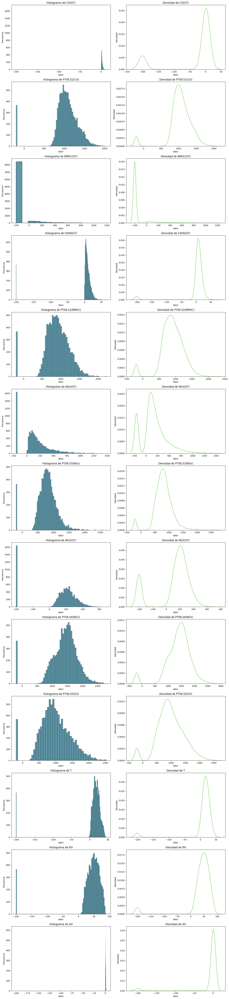

In [ ]:
# Lista de columnas de contaminantes
columns = ['CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
           'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
           'T', 'RH', 'AH']

# Crear una figura y ejes para cada columna (contaminante)
num_columns = len(columns)
fig, axs = plt.subplots(num_columns, 2, figsize=(15, 5 * num_columns))

# Asegurarse de que axs sea siempre una lista de ejes, incluso si es solo uno
if num_columns == 1:
    axs = [axs]

#Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', 256)

# Seleccionar dos colores de la paleta 'viridis'
color_hist = viridis_palette[100]  # Un color para el histograma
color_kde = viridis_palette[200]  # Otro color para el gráfico de densidad

# Iterar sobre cada columna de contaminante
for i, column in enumerate(columns):
    # Crear histograma
    sns.histplot(df[column], kde=False, ax=axs[i, 0], color=color_hist) #Kde desactiva la estimacion de densidad del histograma
    axs[i, 0].set_title(f'Histograma de {column}')
    axs[i, 0].set_xlabel('Valor')
    axs[i, 0].set_ylabel('Frecuencia')

    # Crear gráfico de densidad
    sns.kdeplot(df[column], ax=axs[i, 1], color=color_kde)
    axs[i, 1].set_title(f'Densidad de {column}')
    axs[i, 1].set_xlabel('Valor')
    axs[i, 1].set_ylabel('Densidad')

plt.tight_layout()
plt.show()

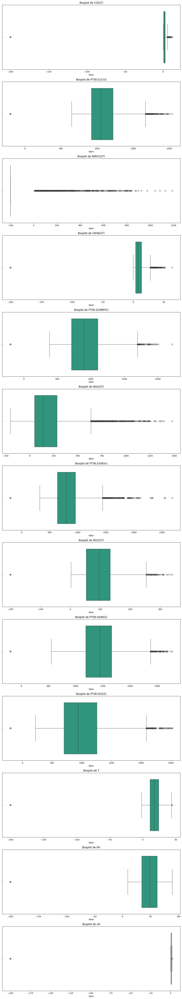

In [ ]:
# Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', 256)

# Seleccionar un color específico de la paleta 'viridis'
viridis_color = viridis_palette[150]

# Crear subplots para cada columna en un gráfico separado
num_columns = len(columns)
fig, axs = plt.subplots(num_columns, 1, figsize=(12, 5 * num_columns))

for i, column in enumerate(columns):
    sns.boxplot(x=df[column], ax=axs[i], color=viridis_color)
    axs[i].set_title(f'Boxplot de {column}')
    axs[i].set_xlabel('Valor')

plt.tight_layout()
plt.show()

Dadas las distribuciones e histogramas podemos analizar que el valor -200, el cual fue imputado es el que mas impacto tiene el los datos anomalos de todas las categorias.
Estos valores se pueden observar en todas las columnas del data set.



##Análisis transformando los -200 a valores NaN

Dado el gran impacto de los valores de -200 imputados, observemos el mismo analisis realizado antes pero a un nuevo dataset donde reemplazamos los valores de -200 por valores NaN.

Esto ayudará en el preprocesamiento de los datos y analizar una posible imputacion diferente a la realizada originalmente.

In [ ]:
df_copy = df.copy()
df_copy.replace(-200, np.nan, inplace=True)

In [ ]:
df_copy.head(30)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16,Datatime,Hour
0,10/03/2004,18:00:00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,NaN,NaN,2004-03-10 18:00:00,18.0
1,10/03/2004,19:00:00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,NaN,NaN,2004-03-10 19:00:00,19.0
2,10/03/2004,20:00:00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,NaN,NaN,2004-03-10 20:00:00,20.0
3,10/03/2004,21:00:00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,NaN,NaN,2004-03-10 21:00:00,21.0
4,10/03/2004,22:00:00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,NaN,NaN,2004-03-10 22:00:00,22.0
5,10/03/2004,23:00:00,1.2,1197.0,38.0,4.7,750.0,89.0,1337.0,96.0,1393.0,949.0,11.2,59.2,0.7848,NaN,NaN,2004-03-10 23:00:00,23.0
6,11/03/2004,00:00:00,1.2,1185.0,31.0,3.6,690.0,62.0,1462.0,77.0,1333.0,733.0,11.3,56.8,0.7603,NaN,NaN,2004-03-11 00:00:00,0.0
7,11/03/2004,01:00:00,1.0,1136.0,31.0,3.3,672.0,62.0,1453.0,76.0,1333.0,730.0,10.7,60.0,0.7702,NaN,NaN,2004-03-11 01:00:00,1.0
8,11/03/2004,02:00:00,0.9,1094.0,24.0,2.3,609.0,45.0,1579.0,60.0,1276.0,620.0,10.7,59.7,0.7648,NaN,NaN,2004-03-11 02:00:00,2.0
9,11/03/2004,03:00:00,0.6,1010.0,19.0,1.7,561.0,NaN,1705.0,NaN,1235.0,501.0,10.3,60.2,0.7517,NaN,NaN,2004-03-11 03:00:00,3.0


Didtribucion de los datos nulos

<Axes: >

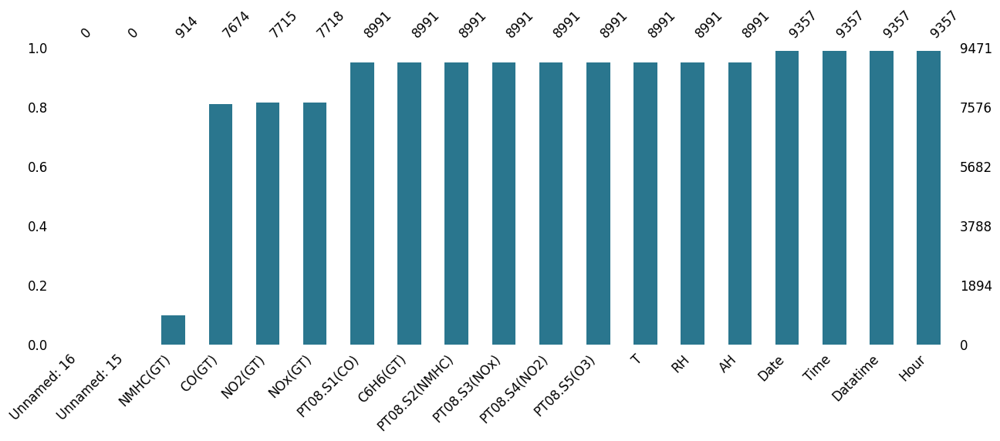

In [ ]:
# Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', 256)

# Seleccionar un color específico de la paleta 'viridis'
viridis_color = viridis_palette[100]  # Puedes cambiar el índice para seleccionar un color diferente

# Graficar la matriz de valores faltantes
msno.bar(df_copy, figsize=(15, 5), sort="ascending", fontsize=12, color=viridis_color)

Podemos obsevar que de los nuevos valores NaN, los antigüos valores -200, estan distribuidos:
* 480 veces en las categorias `'PT08.S1(CO)','C6H6(GT)','PT08.S2(NMHC)', 'PT08.S3(NOx)','PT08.S4(NO2)','PT08.S5(O3)','T', 'RH', 'AH'`
* 1753 veces en las categorias : `'CO(GT)','NO2(GT)','NOx(GT)'`
* 8557 veces en `'NMHC(GT)'`

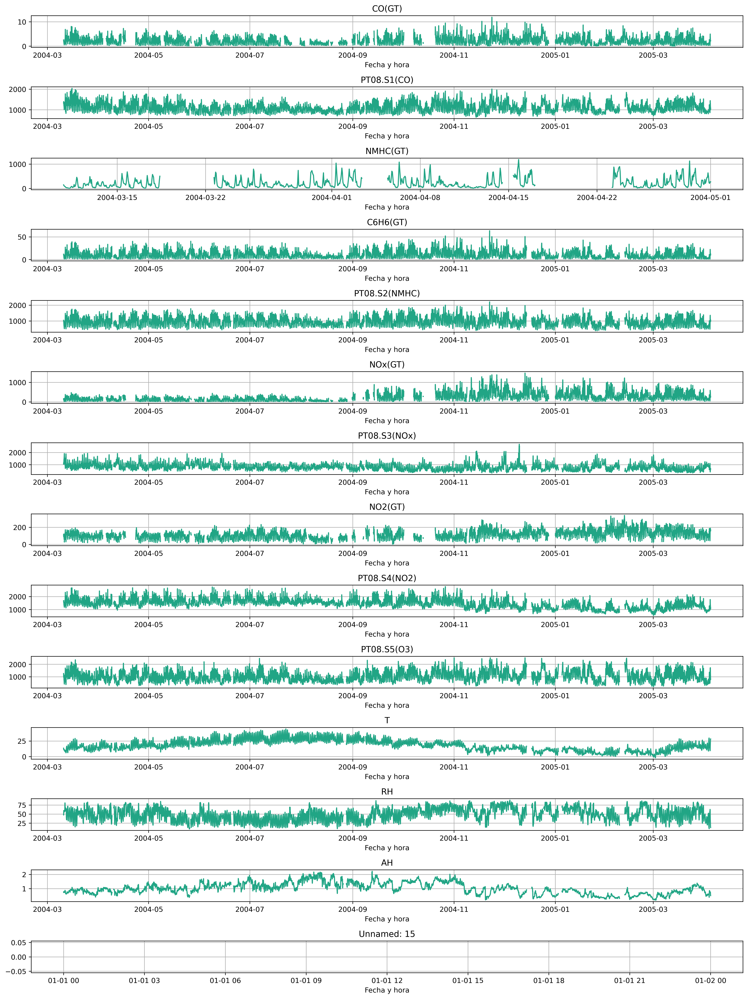

In [ ]:
# Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', 256)

# Seleccionar un color específico de la paleta 'viridis'
viridis_color = viridis_palette[150]
# Crear subplots para cada columna en un gráfico separado
num_columns = len(df_copy.columns[2:-3])
fig, axs = plt.subplots(num_columns, 1, figsize=(15, 20), dpi=400)

for i, column in enumerate(df_copy.columns[2:-3]):
    axs[i].plot(df_copy['Datatime'], df_copy[column], color=viridis_color)
    axs[i].set_title(column)
    axs[i].set_xlabel('Fecha y hora')
    axs[i].set_ylabel('')
    axs[i].grid(True)

plt.tight_layout()
plt.show()

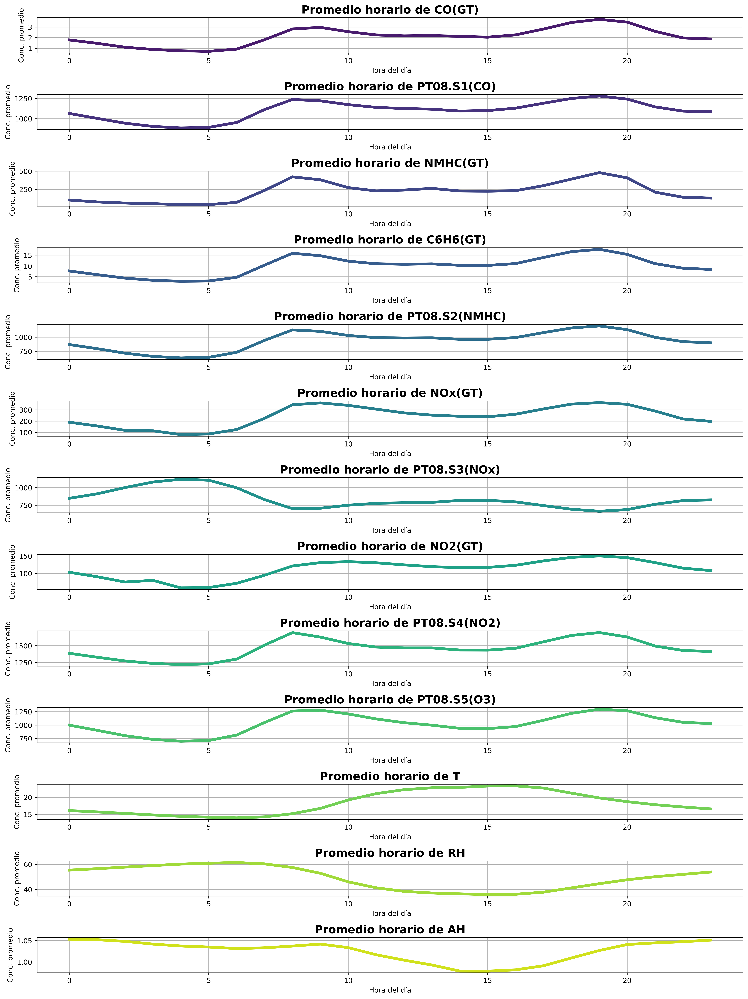

In [ ]:
# Extraer la hora de la columna 'Datatime'
df_copy['Hour'] = df_copy['Datatime'].dt.hour

# Crear una figura y ejes para cada columna
num_columns = len(df_copy.columns[2:-4])
fig, axs = plt.subplots(num_columns, 1, figsize=(15, 20),dpi=400)

#colores a usar
palette = sns.color_palette("viridis", num_columns)

# Iterar sobre cada columna
for i, column in enumerate(df_copy.columns[2:-4]):
    # Agrupar por hora y calcular el promedio
    hourly_means = df_copy.groupby('Hour')[column].mean()

    # Graficar las medias horarias

    axs[i].plot(hourly_means.index, hourly_means.values,color=palette[i],linewidth=4)
    axs[i].set_title(f'Promedio horario de {column}',fontsize=16,fontweight='bold')
    axs[i].set_xlabel('Hora del día')
    axs[i].set_ylabel('Conc. promedio')
    axs[i].grid(True)

plt.tight_layout()
plt.show()

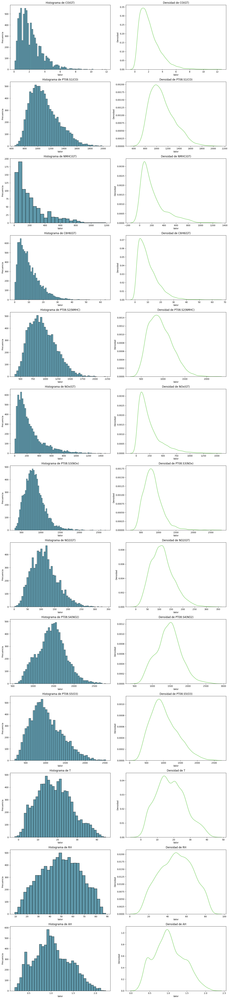

In [ ]:
# Lista de columnas de contaminantes
columns = ['CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
           'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
           'T', 'RH', 'AH']

# Crear una figura y ejes para cada columna (contaminante)
num_columns = len(columns)
fig, axs = plt.subplots(num_columns, 2, figsize=(15, 5 * num_columns))

# Asegurarse de que axs sea siempre una lista de ejes, incluso si es solo uno
if num_columns == 1:
    axs = [axs]

#Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', 256)

# Seleccionar dos colores de la paleta 'viridis'
color_hist = viridis_palette[100]  # Un color para el histograma
color_kde = viridis_palette[200]  # Otro color para el gráfico de densidad

# Iterar sobre cada columna de contaminante
for i, column in enumerate(columns):
    # Crear histograma
    sns.histplot(df_copy[column], kde=False, ax=axs[i, 0], color=color_hist) #Kde desactiva la estimacion de densidad del histograma
    axs[i, 0].set_title(f'Histograma de {column}')
    axs[i, 0].set_xlabel('Valor')
    axs[i, 0].set_ylabel('Frecuencia')

    # Crear gráfico de densidad
    sns.kdeplot(df_copy[column], ax=axs[i, 1], color=color_kde)
    axs[i, 1].set_title(f'Densidad de {column}')
    axs[i, 1].set_xlabel('Valor')
    axs[i, 1].set_ylabel('Densidad')

plt.tight_layout()
plt.show()

In [ ]:
# Lista de columnas de contaminantes
columns = ['CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
           'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
           'T', 'RH', 'AH']

# Número de columnas a mostrar en la cuadrícula
num_cols = 4  # Puedes cambiar este valor para ajustar la distribución horizontal
num_rows = (len(columns) + num_cols - 1) // num_cols  # Calcular filas necesarias

# Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', len(columns))

# Crear una figura y ejes para cada columna (contaminante)
fig, axs = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows),dpi=600)
axs = axs.flatten()  # Aplanar los ejes para facilitar la iteración

# Iterar sobre cada columna de contaminante
for i, column in enumerate(columns):
    # Graficar histograma y gráfico de densidad usando displot
    sns.histplot(df_copy[column], kde=True, ax=axs[i], color=viridis_palette[i])

    # Configurar títulos y etiquetas
    axs[i].set_title(f'{column}')
    axs[i].set_xlabel('Valor')
    axs[i].set_ylabel('Frecuencia/Densidad')

# Eliminar ejes vacíos si el número de columnas no es múltiplo de num_cols
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

In [ ]:
# Definir la paleta 'viridis'
viridis_palette = sns.color_palette('viridis', 256)

# Seleccionar un color específico de la paleta 'viridis'
viridis_color = viridis_palette[150]
fig, axs = plt.subplots(num_columns, 1, figsize=(12, 5 * num_columns),dpi=600)

for i, column in enumerate(columns):
    sns.boxplot(x=df_copy[column], ax=axs[i], color=viridis_color)
    axs[i].set_title(f'Boxplot de {column}')
    axs[i].set_xlabel('Valor')

plt.tight_layout()
plt.show()

Ahora si podemos ver los valores extremos con mas claridad y las distribuciones de las categorias.

**Notas Finales - Futuros Pasos**


*Imputación Alternativa*: Se puede considerar métodos de imputación alternativos, como la imputación por la media, mediana o técnicas avanzadas como KNN, si es necesario para un análisis más robusto.

*Extraccion y Análisis de Selección de Datos*: Se tiene que reconciderar la utilizacion de ciertas categorias y registros extremos, dependiendo de los objetivos a trabajar.
